In [1]:
# ипрортируем библиотеки

import numpy as np
import pandas as pd
import missingno as msn
import matplotlib.pyplot as plt
import ydata_profiling
import seaborn as sns
from sklearn.preprocessing import LabelEncoder


In [2]:

# загружаем набор данных
data = pd.read_csv('C://Users/alex1/Downloads/Billionaires Statistics Dataset.csv')
data_copy = data.copy()
data_copy.head()

#Посмотрел датафрейм

,rank,finalWorth,category,personName,age,country,city,source,industries,countryOfCitizenship,...,cpi_change_country,gdp_country,gross_tertiary_education_enrollment,gross_primary_education_enrollment_country,life_expectancy_country,tax_revenue_country_country,total_tax_rate_country,population_country,latitude_country,longitude_country
0,1,211000,Fashion & Retail,Bernard Arnault & family,74.0,France,Paris,LVMH,Fashion & Retail,France,...,1.1,"$2,715,518,274,227",65.6,102.5,82.5,24.2,60.7,67059887.0,46.227638,2.213749
1,2,180000,Automotive,Elon Musk,51.0,United States,Austin,"Tesla, SpaceX",Automotive,United States,...,7.5,"$21,427,700,000,000",88.2,101.8,78.5,9.6,36.6,328239523.0,37.090240,-95.712891
2,3,114000,Technology,Jeff Bezos,59.0,United States,Medina,Amazon,Technology,United States,...,7.5,"$21,427,700,000,000",88.2,101.8,78.5,9.6,36.6,328239523.0,37.090240,-95.712891
3,4,107000,Technology,Larry Ellison,78.0,United States,Lanai,Oracle,Technology,United States,...,7.5,"$21,427,700,000,000",88.2,101.8,78.5,9.6,36.6,328239523.0,37.090240,-95.712891
4,5,106000,Finance & Investments,Warren Buffett,92.0,United States,Omaha,Berkshire Hathaway,Finance & Investments,United States,...,7.5,"$21,427,700,000,000",88.2,101.8,78.5,9.6,36.6,328239523.0,37.090240,-95.712891


In [4]:
data_copy.shape
# посмотрел размер датафрейма

(2640, 35)

In [5]:
data_copy = data_copy.drop_duplicates()
data_copy.shape
# проверка на дубликаты, с помощью фунекции удалил повторы, размер датафрейма не изменился
# дубликатов не обнаружено

(2640, 35)

<AxesSubplot: >

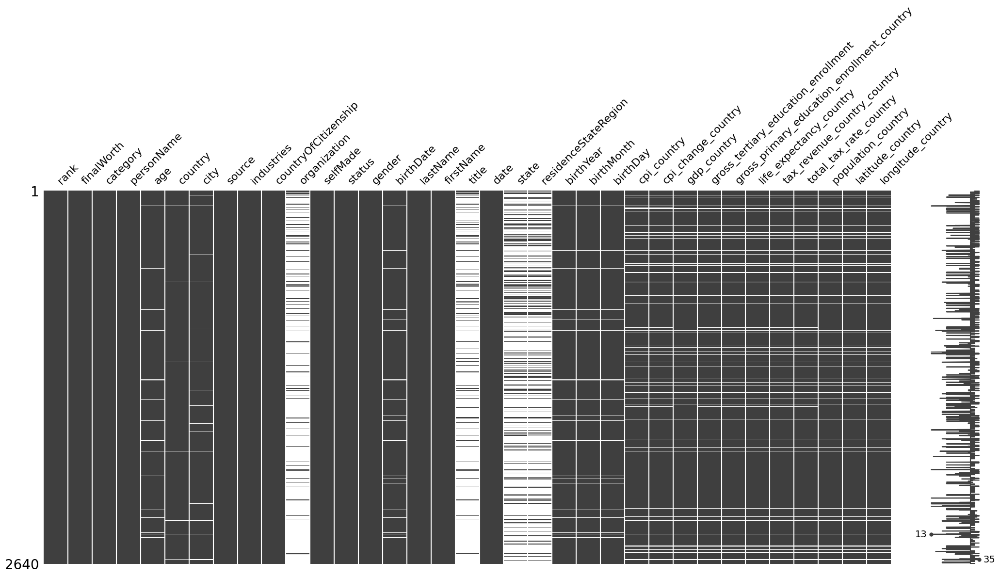

In [6]:
msn.matrix(data_copy)
#построил матрицу Null значений, в нескольких столбцах обнаружены пустые значения

In [7]:
data_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2640 entries, 0 to 2639
Data columns (total 35 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   rank                                        2640 non-null   int64  
 1   finalWorth                                  2640 non-null   int64  
 2   category                                    2640 non-null   object 
 3   personName                                  2640 non-null   object 
 4   age                                         2575 non-null   float64
 5   country                                     2602 non-null   object 
 6   city                                        2568 non-null   object 
 7   source                                      2640 non-null   object 
 8   industries                                  2640 non-null   object 
 9   countryOfCitizenship                        2640 non-null   object 
 10  organization

In [9]:
for column in data_copy.columns:
    nan_count = data_copy[column].isnull().sum()
    total_count = len(data_copy[column])
    percentage = nan_count/total_count*100
    print(f'Процент NaN значений в столбце {column} равен {percentage}%')
# вывод процента пропущеннных значений по столбцам  
# столбцы: state, title, organization, residenceStateRegion можно дропнуть, т.к. процент потерь данных, превышет 50%

Процент NaN значений в столбце rank равен 0.0%
Процент NaN значений в столбце finalWorth равен 0.0%
Процент NaN значений в столбце category равен 0.0%
Процент NaN значений в столбце personName равен 0.0%
Процент NaN значений в столбце age равен 2.462121212121212%
Процент NaN значений в столбце country равен 1.4393939393939394%
Процент NaN значений в столбце city равен 2.727272727272727%
Процент NaN значений в столбце source равен 0.0%
Процент NaN значений в столбце industries равен 0.0%
Процент NaN значений в столбце countryOfCitizenship равен 0.0%
Процент NaN значений в столбце organization равен 87.68939393939394%
Процент NaN значений в столбце selfMade равен 0.0%
Процент NaN значений в столбце status равен 0.0%
Процент NaN значений в столбце gender равен 0.0%
Процент NaN значений в столбце birthDate равен 2.878787878787879%
Процент NaN значений в столбце lastName равен 0.0%
Процент NaN значений в столбце firstName равен 0.11363636363636363%
Процент NaN значений в столбце title равен

<AxesSubplot: >

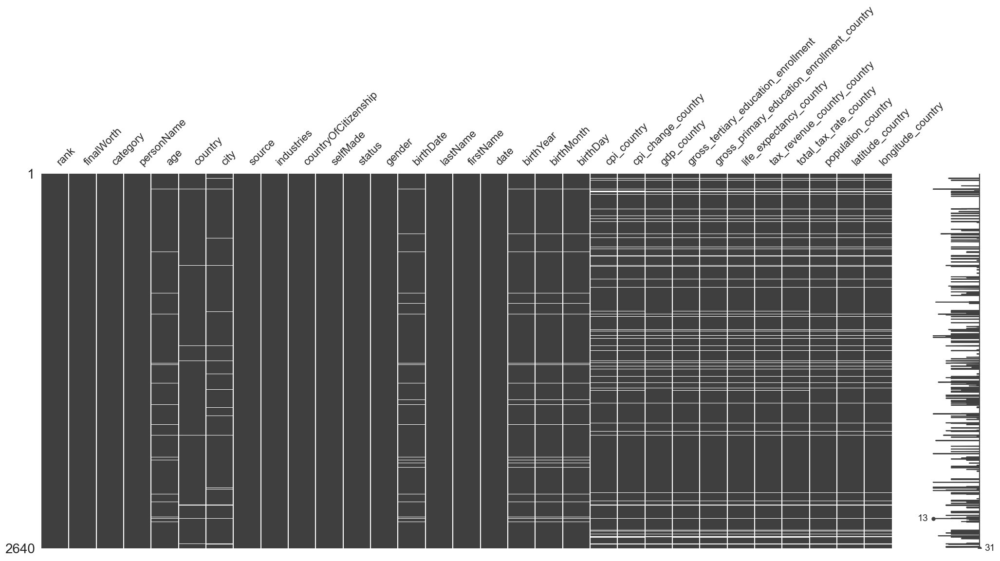

In [4]:
data_copy_enc = data_copy.drop(['state','title','organization','residenceStateRegion'],axis = 1)
msn.matrix(data_copy_enc)
#построил матрицу Null значений, теперь матрица выглядит получше

In [5]:
top_country = data_copy_enc.groupby('country').size().reset_index(name='bogat_count')
top_country = top_country.sort_values(by='bogat_count', ascending=False).head(10)
top_country
# Топ стран по количеству богатых человек (России нет((((( )

,country,bogat_count
74,United States,754
16,China,523
31,India,157
26,Germany,102
73,United Kingdom,82
58,Russia,79
65,Switzerland,78
29,Hong Kong,68
35,Italy,55
59,Singapore,46


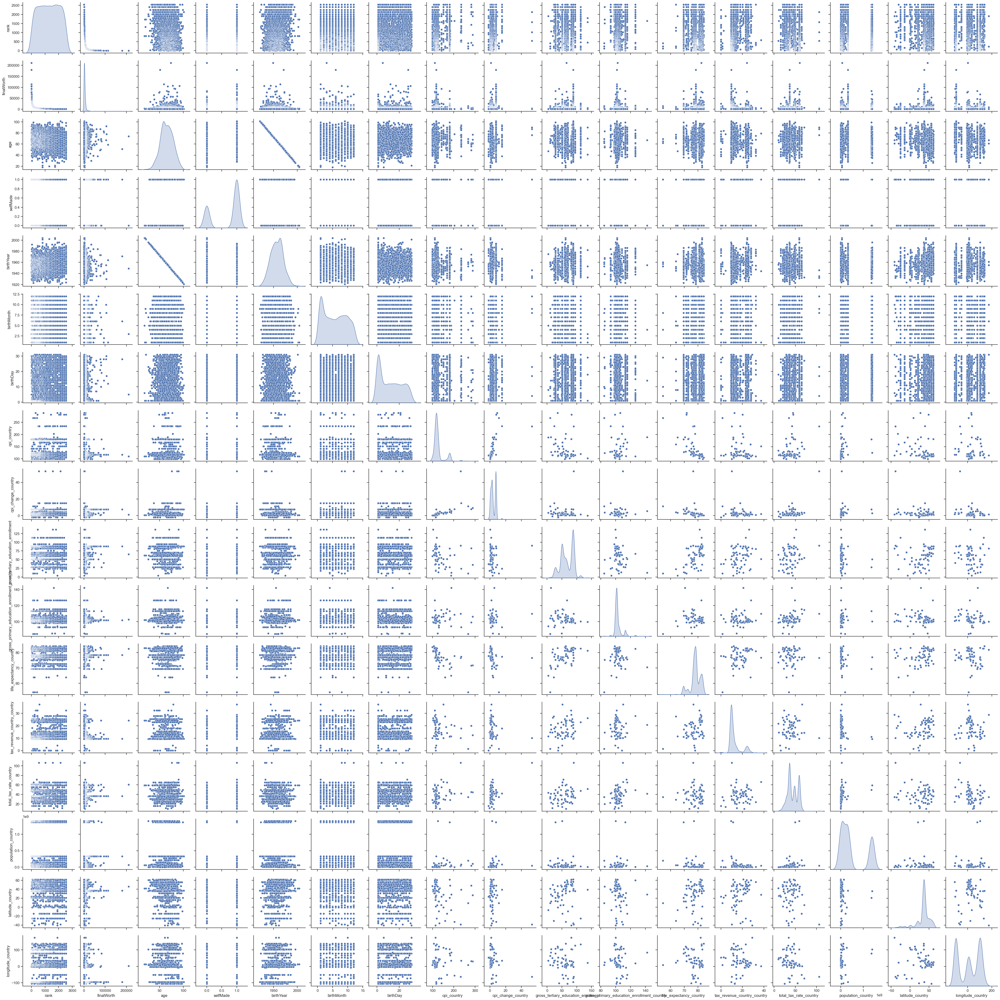

In [6]:
sns.set(style="ticks")
sns.pairplot(data_copy_enc, diag_kind='kde')
plt.show()
# создание точечной диаграммы (pairplot)

In [7]:
ydata_profiling.ProfileReport(data_copy_enc)
# Визуализация data_profiling для описания основных характеристик и свойств данных.

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [18]:
data_copy_enc['industries'].unique()
# уникальные значения в индустрии

array(['Fashion & Retail', 'Automotive', 'Technology',
       'Finance & Investments', 'Media & Entertainment', 'Telecom',
       'Diversified', 'Food & Beverage', 'Logistics',
       'Gambling & Casinos', 'Manufacturing', 'Real Estate',
       'Metals & Mining', 'Energy', 'Healthcare', 'Service',
       'Construction & Engineering', 'Sports'], dtype=object)

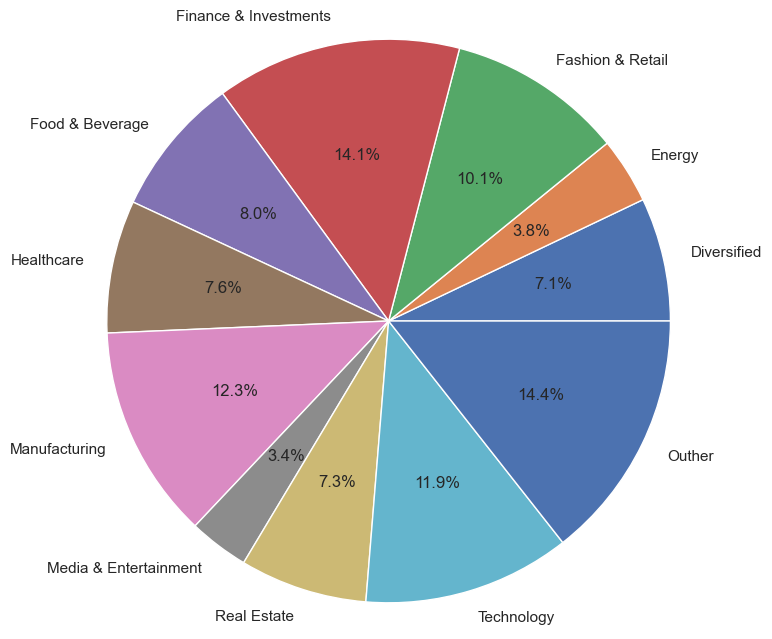

In [56]:
plt.figure(figsize=(8, 8))
grup_df = data_copy_enc.groupby(by = 'industries' ).size().reset_index(name='final_worth')

label = grup_df.index
sizes = grup_df.values

labels = {sizes[i][0]: sizes[i][1] for i in range(len(sizes))}

outher = 0
ss = []
for name, val in labels.items():
    if val/sum(labels.values())*100 <= 3:
        outher += val
        ss.append(name)
for i in ss:
    del labels[i]
labels['Outher']  = outher
# Отображение круговой диаграммы

plt.pie(list(labels.values()), labels=list(labels.keys()), autopct='%1.1f%%')
plt.axis('equal')






# Визуализация категорий индустрии 
plt.show()


In [9]:
data_copy_enc.columns
# просмотрел столбцы

Index(['rank', 'finalWorth', 'category', 'personName', 'age', 'country',
       'city', 'source', 'industries', 'countryOfCitizenship', 'selfMade',
       'status', 'gender', 'birthDate', 'lastName', 'firstName', 'date',
       'birthYear', 'birthMonth', 'birthDay', 'cpi_country',
       'cpi_change_country', 'gdp_country',
       'gross_tertiary_education_enrollment',
       'gross_primary_education_enrollment_country', 'life_expectancy_country',
       'tax_revenue_country_country', 'total_tax_rate_country',
       'population_country', 'latitude_country', 'longitude_country'],
      dtype='object')

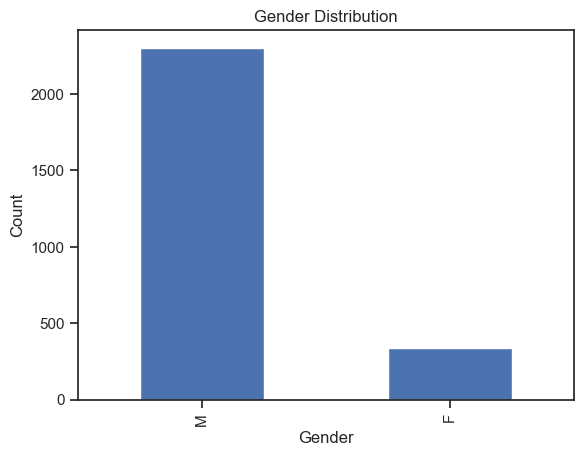

In [10]:
import matplotlib.pyplot as plt

data_copy_enc['gender'].value_counts().plot(kind='bar')
plt.title('Gender Distribution')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.show()
# построил график статистики миллионеров по полу

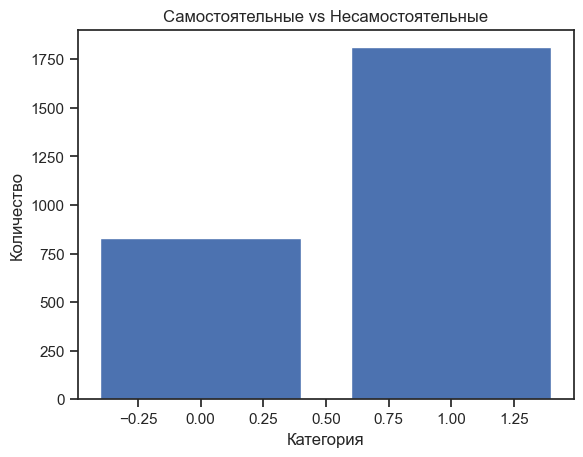

In [11]:
self_made_counts = data_copy_enc['selfMade'].value_counts()


plt.bar(self_made_counts.index, self_made_counts.values)
plt.xlabel('Категория')
plt.ylabel('Количество')
plt.title('Самостоятельные vs Несамостоятельные')
plt.show()
# построил график миллионеров по тому, как они стали такими (сами или нет)

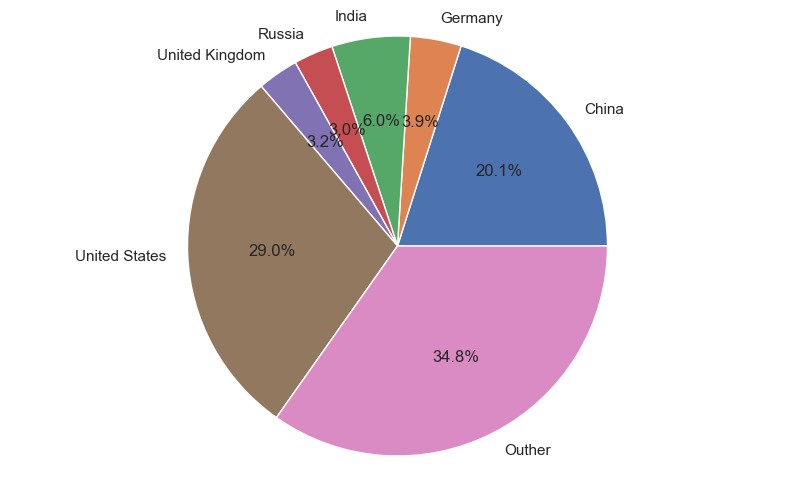

In [68]:
country = data_copy_enc.groupby(by = 'country' ).size()
label = country.index
sizes = country.values
plt.figure(figsize=(10, 6))
labels = {label[i]: sizes[i] for i in range(len(sizes))}

outher = 0
ss = []
for name, val in labels.items():
    if val/sum(labels.values())*100 < 3:
        outher += val
        ss.append(name)
for i in ss:
    del labels[i]
labels['Outher']  = outher
# Отображение круговой диаграммы

plt.pie(list(labels.values()), labels=list(labels.keys()), autopct='%1.1f%%')


plt.axis('equal')

plt.show()
# посмотрел количество миллионеров в каждой стране

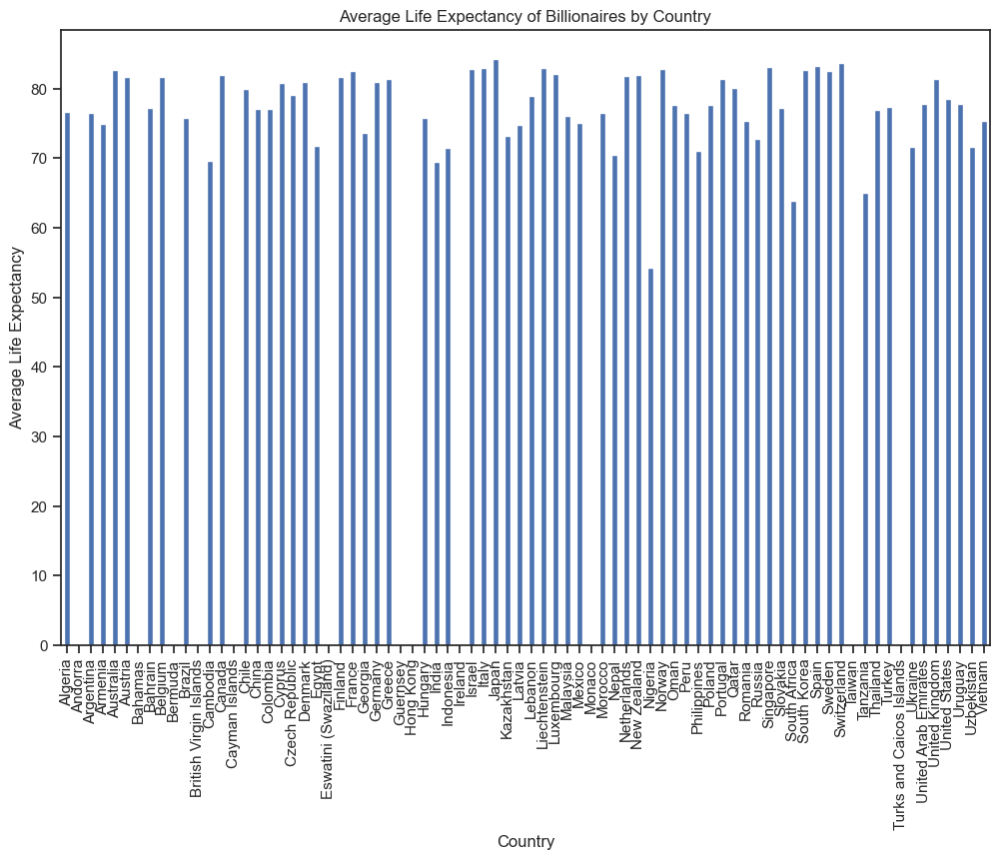

In [64]:
average_life_expectancy_by_country = data_copy_enc.groupby('country')['life_expectancy_country'].mean()
average_life_expectancy_by_country.plot(kind='bar', figsize=(12, 8))
plt.title('Average Life Expectancy of Billionaires by Country')
plt.xlabel('Country')
plt.ylabel('Average Life Expectancy')
plt.show()
# Средняя продолжительность жизни миллиардеров по странам

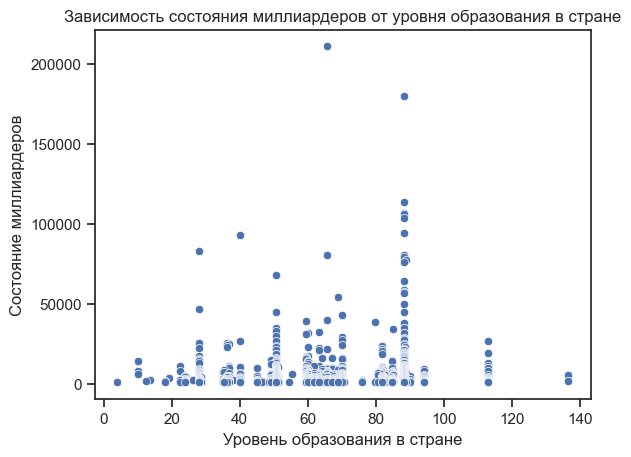

In [67]:
import seaborn as sns

sns.scatterplot(x='gross_tertiary_education_enrollment', y='finalWorth', data=data_copy_enc)
plt.xlabel('Уровень образования в стране')
plt.ylabel('Состояние миллиардеров')
plt.title('Зависимость состояния миллиардеров от уровня образования в стране')
plt.show()